## QC and annotation of single cells for RNA Velocity
By Monika Litvinukova <br/>
Latest update 23.07.20

### Import required modules

In [1]:
import bbknn
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import scipy as sp
import seaborn as sb
from matplotlib import rcParams
from matplotlib import colors
import matplotlib.pyplot as plt

/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
def regress_pca(pca, batch):
    regressors = np.zeros(pca.shape, dtype = 'float64')
    regressed = np.zeros(pca.shape, dtype = 'float64')
    for category in np.unique(batch):
        mask = (category == batch)
        regressors[mask,:] = np.mean(pca[mask,:],axis = 0)
    for i in range(pca.shape[1]):
        t = np.c_[np.ones(regressors[:,i].shape),regressors[:,i]]
        b = np.dot(np.dot(np.linalg.inv(np.dot(t.T,t)),t.T),pca[:,i])
        regressed[:,i] = pca[:,i] - b[0] - b[1] * t[:,1]
    return regressed

In [3]:
sc.settings.verbosity = 3
sc.logging.print_version_and_date()
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')

Running Scanpy 1.4.4.post1, on 2020-01-09 22:22.


## Read in data

In [4]:
cells_raw = sc.read_h5ad('/home/jovyan/data/Dec/0-global/Velocity/hca_heart_cdna-cd45_ctl191128_QCed_scrublet.h5ad')
cells_raw

AnnData object with n_obs × n_vars = 228339 × 58721 
    obs: '10X version', 'Age', 'Clusters', 'Donor', 'Gender', 'NRP', 'Region', 'SampleID', 'Source', 'Type', '_X', '_Y', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'percent_ribo', 'n_genes', 'scrublet_score'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [5]:
## remove the samples flagged by Berlin
cells_raw = cells_raw[~cells_raw.obs['sample'].isin(['HCAHeart7850550', 'HCAHeart7827638', 'HCAHeart7606895', 'HCAHeart7964512', 'HCAHeart7827637', 'HCAHeart7827639'])]
cells_raw.shape

(222041, 58721)

In [6]:
pd.crosstab(cells_raw.obs['donor'], cells_raw.obs['region'] )

region,AX,LA,LV,RA,RV,SP
donor,,,,,,
D1,317,0,0,0,0,0
D3,2080,2709,1093,0,539,290
D4,8,875,20,770,234,712
D5,1352,2890,1619,1725,439,732
D6,17262,14814,12161,3791,10685,8560
D7,4827,2306,1642,2323,4809,3830
D11,23764,5465,24568,10720,33861,18249


In [7]:
cells_raw.obs['source'].cat.categories

Index(['CD45+', 'Cells'], dtype='object')

In [8]:
tot_cells_raw = cells_raw[cells_raw.obs['source'].isin(['Cells'])]
tot_cells_raw.shape

(66122, 58721)

In [9]:
pd.crosstab(tot_cells_raw.obs['donor'], tot_cells_raw.obs['region'] )

region,AX,LA,LV,RA,RV,SP
donor,,,,,,
D1,317,0,0,0,0,0
D3,2080,2709,1093,0,539,290
D4,8,875,20,770,234,712
D5,1352,2890,1619,1725,439,732
D6,5484,1315,5251,1696,6765,3189
D7,681,810,579,499,1888,899
D11,5986,449,3814,487,6217,1709


In [10]:
CD45_cells_raw = cells_raw[cells_raw.obs['source'].isin(['CD45+'])]
CD45_cells_raw.shape

(155919, 58721)

In [11]:
pd.crosstab(CD45_cells_raw.obs['donor'], CD45_cells_raw.obs['region'] )

region,AX,LA,LV,RA,RV,SP
donor,,,,,,
D6,11778,13499,6910,2095,3920,5371
D7,4146,1496,1063,1824,2921,2931
D11,17778,5016,20754,10233,27644,16540


## Compute QC metrics and filter low quality cells

In [12]:
# Calculate the total counts
cells_raw.obs['n_counts'].describe()

count    222041.000000
mean       1916.917603
std        2677.362549
min         218.000000
25%         576.000000
50%        1109.000000
75%        2201.000000
max      118113.000000
Name: n_counts, dtype: float64

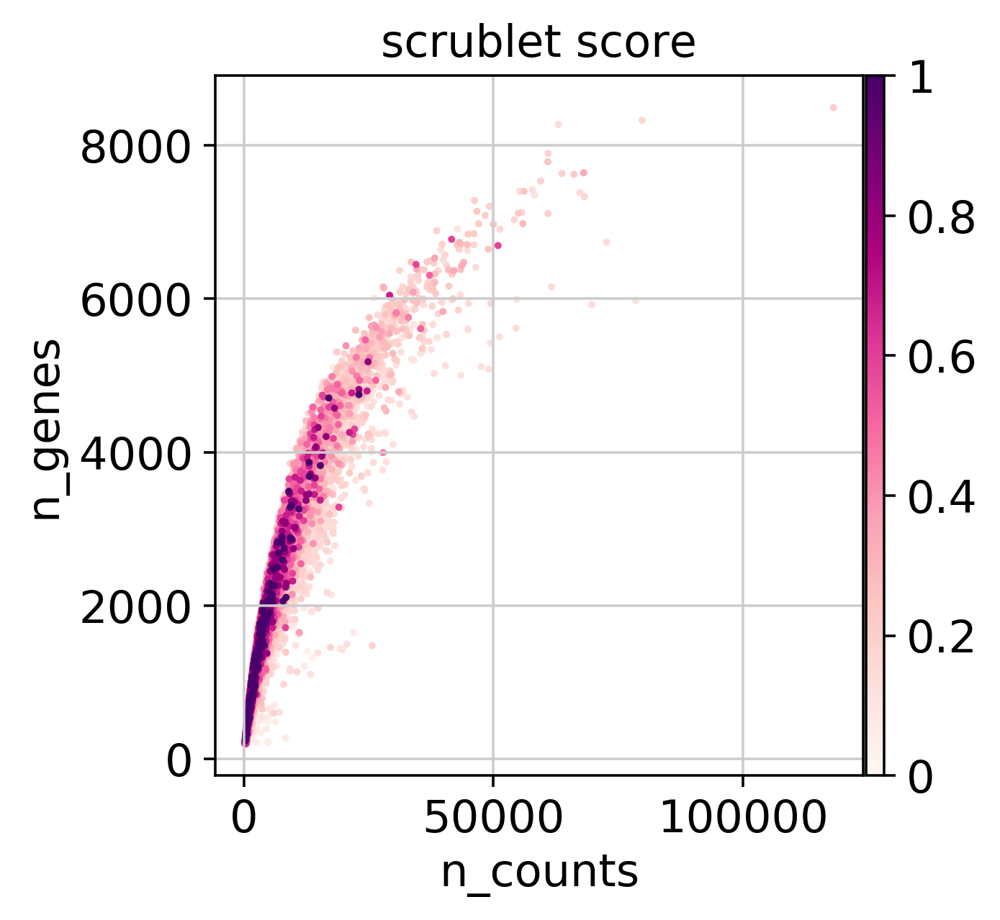

In [13]:
# Data quality summary plots
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')
sc.pl.scatter(cells_raw, 'n_counts', 'n_genes', color = 'scrublet_score', size = 20)
#sc.pl.scatter(cells_raw[cd45_raw.obs['n_counts'] < 20000], 'n_counts', 'n_genes', color = 'percent_mito', size = 20)

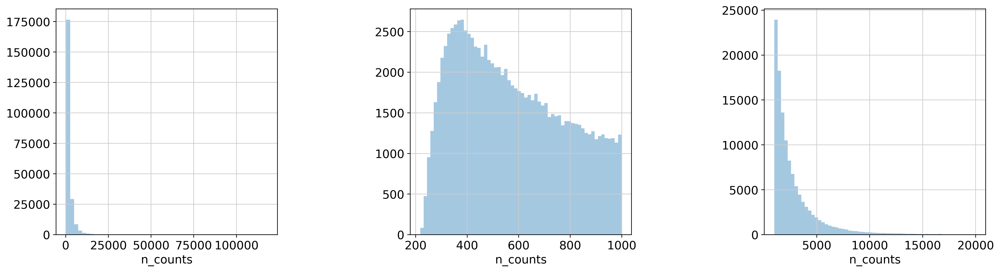

In [14]:
# Thresholding decision: counts

rcParams['figure.figsize'] = (20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(cells_raw.obs['n_counts'], kde = False, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(cells_raw.obs['n_counts'][(cells_raw.obs['n_counts'] > 100) & (cells_raw.obs['n_counts'] < 1000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(cells_raw.obs['n_counts'][(cells_raw.obs['n_counts'] > 1000) & (cells_raw.obs['n_counts'] < 20000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))

plt.show()

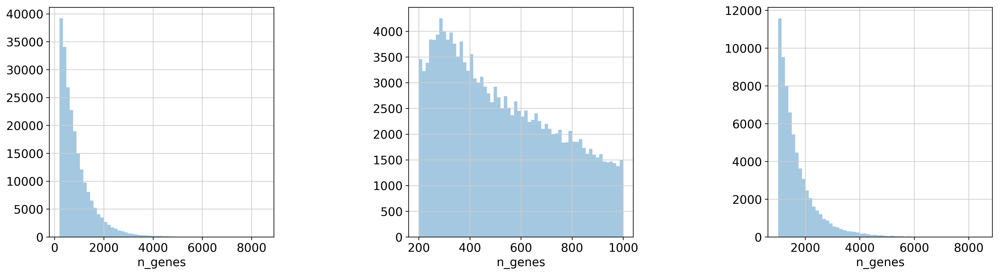

In [15]:
# Thresholding decision: genes

rcParams['figure.figsize']=(20,5)
fig_ind = np.arange(131, 134)
fig = plt.figure()
fig.subplots_adjust(hspace = 0.4, wspace = 0.6)

sb.distplot(cells_raw.obs['n_genes'], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[0]))
sb.distplot(cells_raw.obs['n_genes'][cells_raw.obs['n_genes'] < 1000], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[1]))
sb.distplot(cells_raw.obs['n_genes'][(cells_raw.obs['n_genes'] > 1000) & (cells_raw.obs['n_genes'] < 20000)], kde = False, bins = 60, ax = fig.add_subplot(fig_ind[2]))

plt.show()

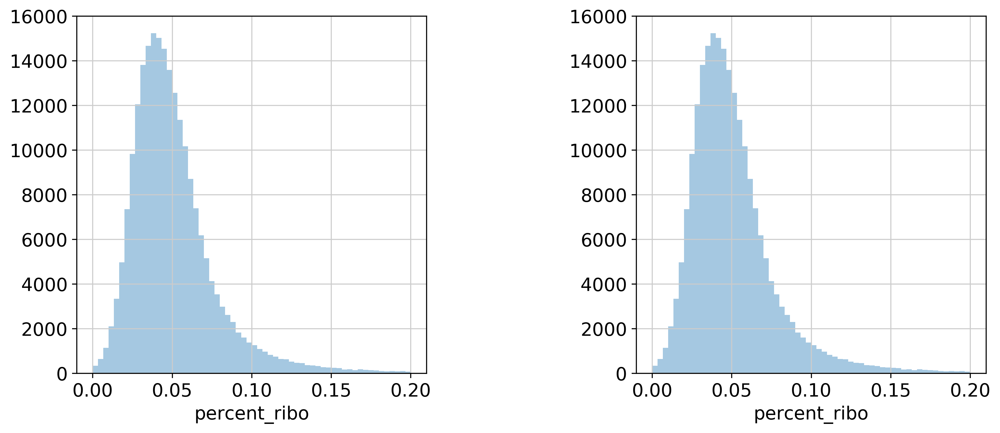

In [16]:
# Thresholding decision: ribosomal reads

rcParams['figure.figsize']=(20,5)
fig_ind=np.arange(131, 133)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

sb.distplot(cells_raw.obs['percent_ribo'], kde=False, bins=60, ax=fig.add_subplot(fig_ind[0]))
sb.distplot(cells_raw.obs['percent_ribo'][cells_raw.obs['percent_ribo'] < 0.2], kde=False, bins=60, ax=fig.add_subplot(fig_ind[1]))
plt.show()

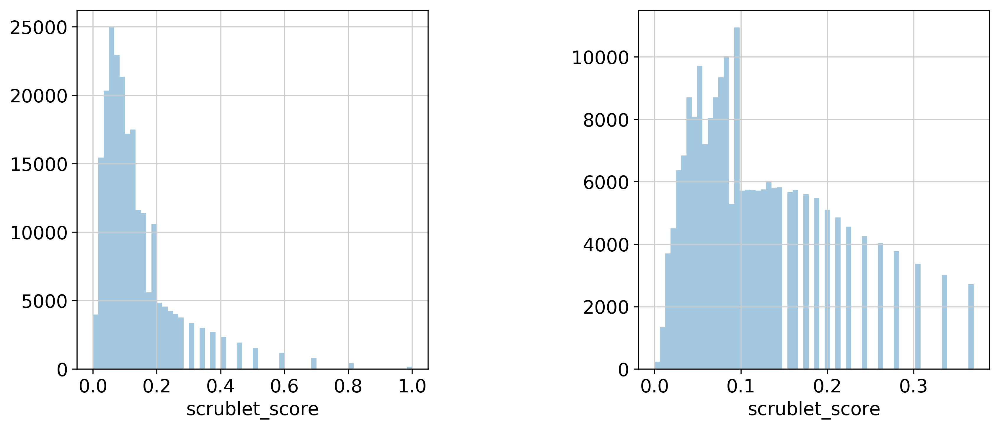

In [17]:
# Thresholding decision: Scrublet

rcParams['figure.figsize']=(20,5)
fig_ind=np.arange(131, 133)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

sb.distplot(cells_raw.obs['scrublet_score'], kde=False, bins=60, ax=fig.add_subplot(fig_ind[0]))
sb.distplot(cells_raw.obs['scrublet_score'][cells_raw.obs['scrublet_score'] < 0.4], kde=False, bins=60, ax=fig.add_subplot(fig_ind[1]))
plt.show()

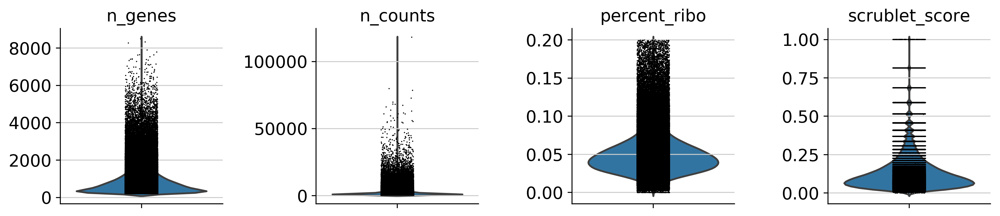

In [18]:
sc.pl.violin(cells_raw, ['n_genes', 'n_counts', 'percent_ribo', 'scrublet_score'], jitter = 0.1, multi_panel = True)

In [19]:
cells_filtered = cells_raw.copy()

In [20]:
# Filter cells according to identified QC thresholds:
print('Total number of cells before filtering: {:d}'.format(cells_filtered.n_obs))

sc.pp.filter_cells(cells_filtered, min_counts = 500)
sc.pp.filter_cells(cells_filtered, max_counts = 15000)
sc.pp.filter_cells(cells_filtered, min_genes = 300)
sc.pp.filter_cells(cells_filtered, max_genes = 6000)
cells_filtered = cells_filtered[cells_filtered.obs['scrublet_score'] < 0.3]

print('Total number of cells after filtering: {:d}'.format(cells_filtered.n_obs))

#Filter genes:
print('Total number of genes: {:d}'.format(cells_filtered.n_vars))

Total number of cells before filtering: 222041
filtered out 43668 cells that haveless than 500 counts
filtered out 1536 cells that havemore than 15000 counts
filtered out 394 cells that haveless than 300 genes expressed
Total number of cells after filtering: 160982
Total number of genes: 58721


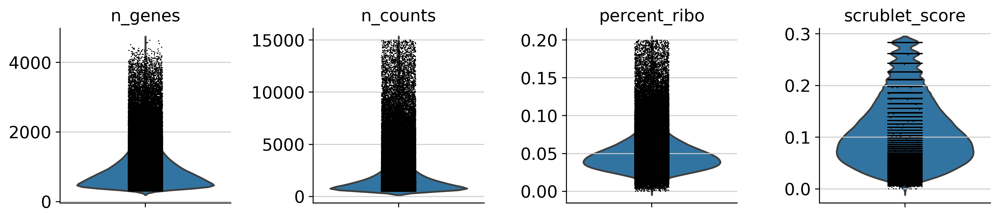

In [21]:
sc.pl.violin(cells_filtered, ['n_genes', 'n_counts', 'percent_ribo', 'scrublet_score'], jitter = 0.1, multi_panel = True)

### Export the QC'd object

In [22]:
cells_filtered.write_h5ad('/home/jovyan/data/Dec/0-global/Velocity/hca_heart_CellsCD45_QCd_ml200109.h5ad')

## Pre-process the dataset

In [23]:
cells_processed = cells_filtered.copy()
sc.pp.normalize_per_cell(cells_processed, counts_per_cell_after = 1e4)
sc.pp.log1p(cells_processed)
cells_processed.raw = cells_processed
cells_processed.shape

normalizing by total count per cell
    finished (0:00:09): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


(160982, 58721)

In [24]:
sc.pp.highly_variable_genes(cells_processed, flavor = 'seurat')
cells_hvg = cells_processed[:, cells_processed.var['highly_variable']]
cells_hvg.shape

extracting highly variable genes
    finished (0:00:09)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


(160982, 2200)

In [25]:
sc.pp.scale(cells_hvg, max_value = 10)

/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [26]:
sc.pp.pca(cells_hvg, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack')
sc.pp.neighbors(cells_hvg)
sc.tl.umap(cells_hvg)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:22)
computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../opt/conda/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parall

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:01:03)
computing UMAP


/opt/conda/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:29)


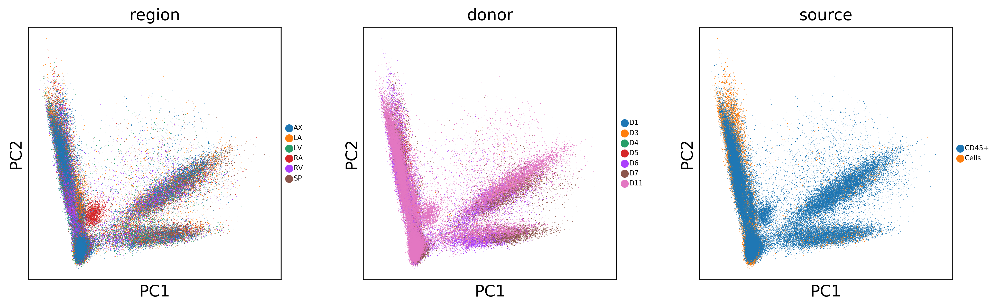

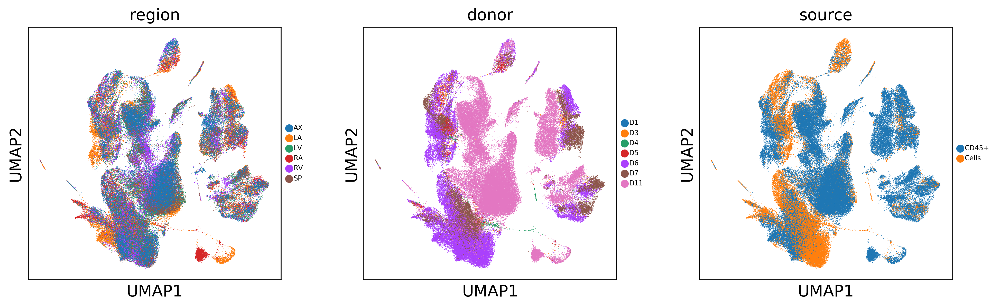

In [27]:
sc.settings.set_figure_params(dpi = 160, color_map = 'RdPu', dpi_save = 180, vector_friendly = True, format = 'svg')
sc.pl.pca_scatter(cells_hvg, color = ['region', 'donor', 'source'], size = 1, legend_fontsize = 6)
sc.pl.umap(cells_hvg, color = ['region', 'donor', 'source'], size = 1, legend_fontsize = 6)

## Batch correction

- donor

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:58)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:03:48)


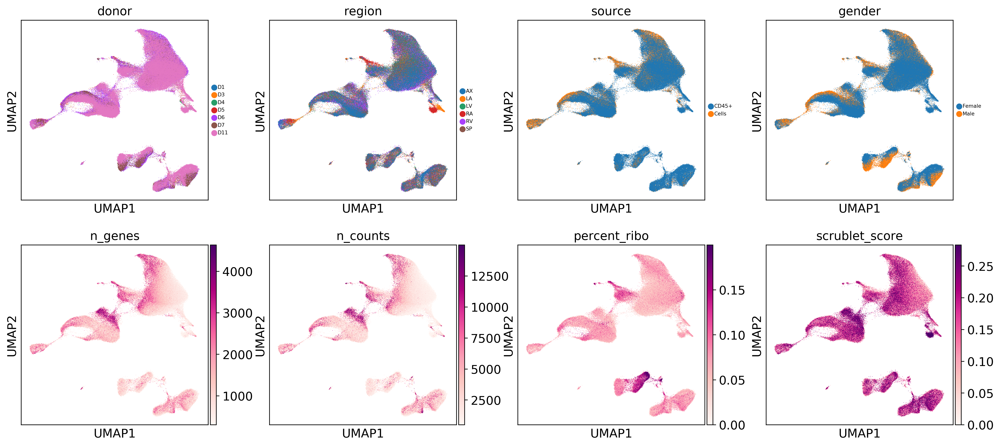

In [29]:
lrkp9_donor = cells_hvg.copy()
lrkp9_donor.obsm['X_pca_original'] = lrkp9_donor.obsm['X_pca'].copy()
lrkp9_donor.obsm['X_pca'] = regress_pca(lrkp9_donor.obsm['X_pca'], lrkp9_donor.obs['donor'])

bbknn_donor = bbknn.bbknn(lrkp9_donor, neighbors_within_batch = 3, batch_key = 'donor', approx = True, copy = True, n_trees = 30)
sc.tl.umap(bbknn_donor, min_dist = 0.3, spread = 1, random_state = 1712)
sc.pl.umap(bbknn_donor, color = ['donor', 'region', 'source', 'gender', 'n_genes', 'n_counts', 'percent_ribo', 'scrublet_score'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

- Combined

running Leiden clustering
    finished: found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:03:25)


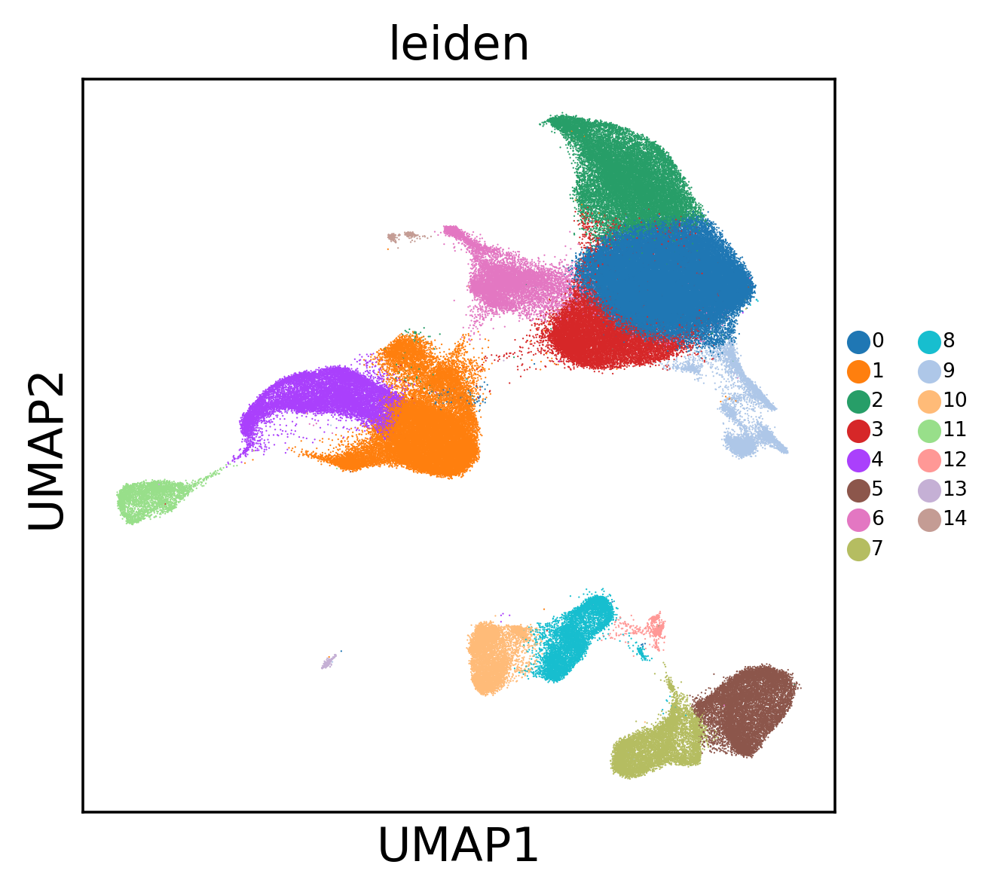

In [32]:
sc.tl.leiden(bbknn_donor, resolution = 0.6, random_state = 1712)
sc.pl.umap(bbknn_donor, color = ['leiden'], size = 1, legend_fontsize = 6, color_map = 'RdPu')

## Annotate the dataset

In [33]:
sc.pl.umap(bbknn_donor, color = ['leiden', 'VWF', 'CA4', 'NEBL', 'CXCL1', 'POSTN', 'ACKR1', 'SEMA3G', 'PROX1', 'TBX1', 'BTNL9', 'CD14', 'C1QA', 'MRC1', 'CD3E', 'NKG7', 'HBB', 'CD79A', 'BANK1', 
                                 'MS4A2', 'CPA3', 'PDGFRA', 'DCN', 'MYH11', 'TAGLN', 'ICAM1', 'ABCC9', 'KCNJ8', 'THBS4', 'CALB2', 'TTN', 'PLP1', 'GFRA3', 'GPAM','ATF3', 'KLF3'], size = 1, legend_fontsize = 6)

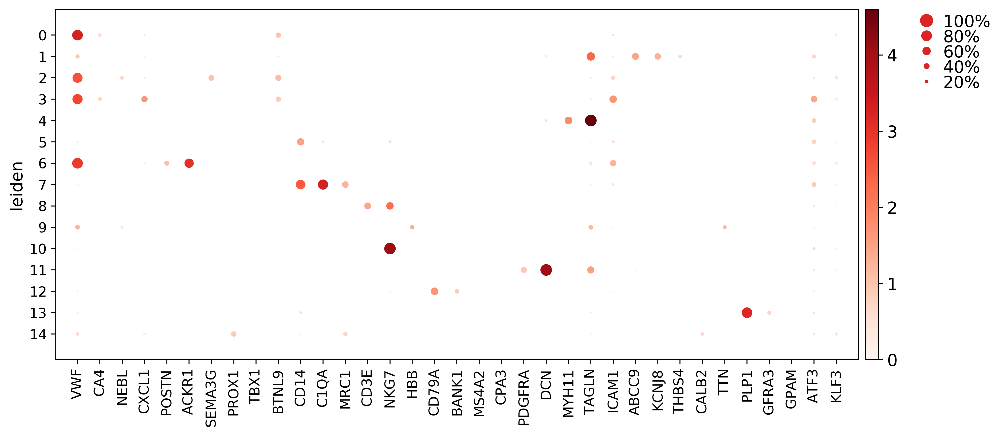

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[12.25, 0, 0.2, 0.5, 0.25])

In [34]:
annotation = ['VWF', 'CA4', 'NEBL', 'CXCL1', 'POSTN', 'ACKR1', 'SEMA3G', 'PROX1', 'TBX1', 'BTNL9', 'CD14', 'C1QA', 'MRC1', 'CD3E', 'NKG7', 'HBB', 'CD79A', 
              'BANK1', 'MS4A2', 'CPA3', 'PDGFRA', 'DCN', 'MYH11', 'TAGLN', 'ICAM1', 'ABCC9', 'KCNJ8', 'THBS4', 'CALB2', 'TTN', 'PLP1', 'GFRA3', 'GPAM','ATF3', 'KLF3']
sc.pl.dotplot(bbknn_donor, annotation, groupby = 'leiden')

### Call markers on leiden

In [35]:
sc.tl.rank_genes_groups(bbknn_donor, 'leiden', method = 'wilcoxon', use_raw = True)
result = bbknn_donor.uns['rank_genes_groups']
groups = result['names'].dtype.names
wilcox_clusters = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges', 'pvals_adj']})
wilcox_clusters.head(10)
#wilcox_clusters.to_csv('/home/jovyan/data/Dec/heart_CellsCD45_Velo_mll191129_wilcox.csv', index = False, sep = ',')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:14:31)


,0_n,0_l,0_p,1_n,1_l,1_p,2_n,2_l,2_p,3_n,...,11_p,12_n,12_l,12_p,13_n,13_l,13_p,14_n,14_l,14_p
0,VWF,3.252142,0.0,AGT,6.313974,0.0,TM4SF1,2.966059,0.0,CXCL2,...,0.0,CXCR4,4.933768,8.453716e-240,PLP1,13.056233,8.292224e-275,EFEMP1,6.236488,1.298629e-127
1,IFI27,3.003022,0.0,NDUFA4L2,5.389008,0.0,HEY1,3.959342,0.0,ZFP36,...,0.0,RPS18,1.810938,1.002526e-236,CDH19,8.946335,9.141091e-260,PDPN,9.222987,1.691211e-124
2,CLDN5,3.190399,0.0,CPE,5.051075,0.0,IGFBP3,4.277637,0.0,SOCS3,...,0.0,RPS27,2.403484,4.196980e-225,CRYAB,5.272063,1.737156e-251,S100A10,2.284342,1.140964e-119
3,TMSB10,1.814541,0.0,IGFBP7,3.309555,0.0,EPAS1,2.221420,0.0,NFKBIA,...,0.0,RPS2,2.039335,7.403610e-224,PMP22,4.740188,1.839033e-244,TIMP1,3.945707,3.621734e-116
4,GNG11,2.488628,0.0,MFGE8,3.798230,0.0,A2M,2.114161,0.0,CCL2,...,0.0,RPL13A,2.100191,1.271859e-221,S100B,10.198312,2.914352e-233,NNMT,3.549458,2.588112e-108
5,LGALS3,2.153992,0.0,MYL9,3.429940,0.0,ID1,2.500669,0.0,PDLIM1,...,0.0,RPS6,1.757332,7.916364e-220,CLU,5.805174,1.062841e-232,RARRES2,4.693264,5.251081e-106
6,SLC9A3R2,2.743016,0.0,GJA4,3.906876,0.0,RAMP2,2.518445,0.0,JUN,...,0.0,RPLP1,1.437977,1.385085e-217,TMEM176B,6.262683,1.392458e-217,RPS12,1.428839,2.265961e-85
7,IFITM3,1.664954,0.0,SPARC,2.732674,0.0,SRGN,1.848686,0.0,TCIM,...,0.0,RPL18A,2.090073,3.281929e-211,CD9,3.214697,1.432893e-216,MMRN1,9.749533,2.307430e-84
8,EGFL7,2.535977,0.0,ACTA2,4.109461,0.0,SLC9A3R2,2.325519,0.0,JUNB,...,0.0,RPL21,2.141718,8.509758e-211,VIM,2.738169,2.526607e-191,RPL37A,1.681664,2.573955e-81
9,CAV1,2.158684,0.0,MAP1B,3.839747,0.0,SEMA3G,4.893116,0.0,KLF4,...,0.0,RPS19,1.783757,1.968871e-210,S100A6,2.520329,9.519932e-191,RPS28,1.563889,2.854129e-77


In [37]:
wilcox_clusters.to_csv('/home/jovyan/data/Dec/0-global/Velocity/heart_CellsCD45_Velo_ml200108_wilcox.csv', index = False, sep = ',')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


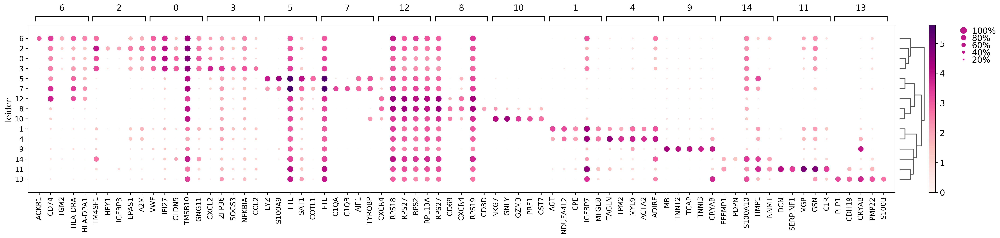

In [36]:
sc.tl.dendrogram(bbknn_donor, groupby = 'leiden')
sc.pl.rank_genes_groups_dotplot(bbknn_donor, n_genes = 5, color_map = 'RdPu')

### Add annotation labels

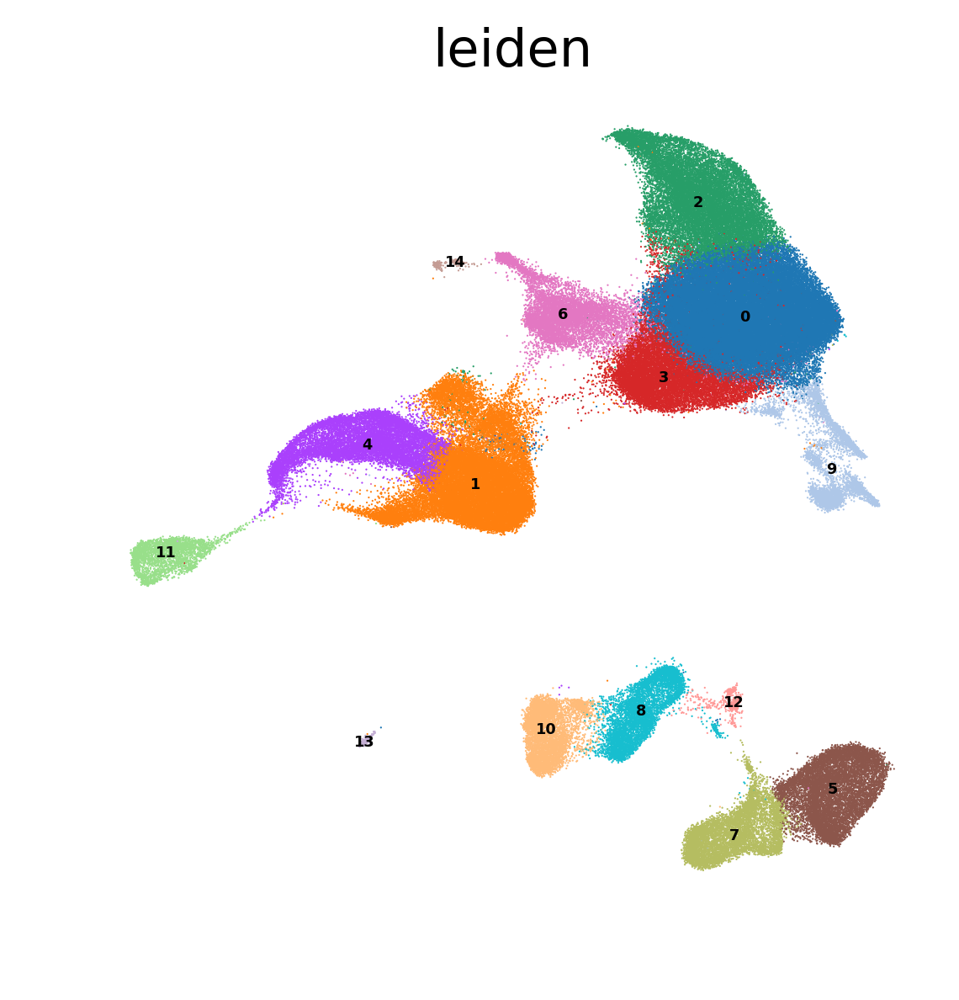

In [38]:
sc.pl.umap(bbknn_donor, color = ['leiden'], size = 1, legend_fontsize = 4, legend_loc = 'on data', frameon = False)

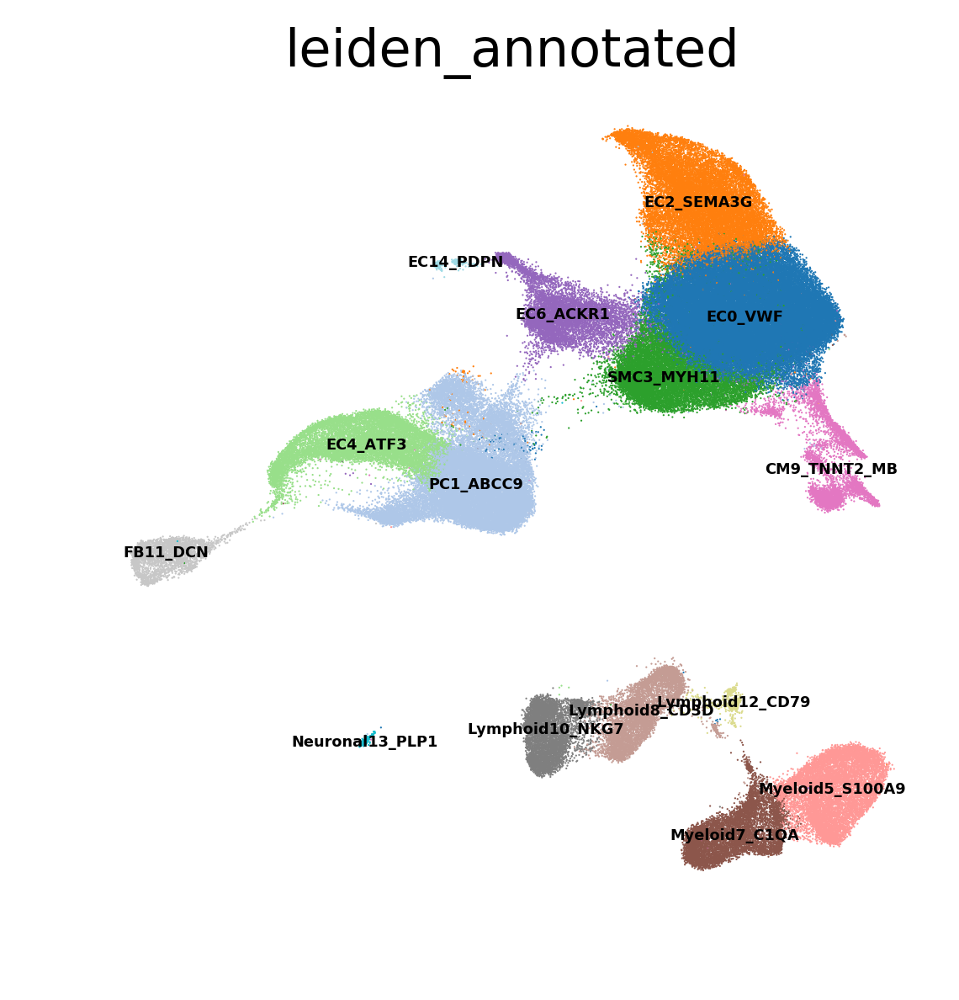

In [39]:
bbknn_donor.obs['leiden_annotated'] = bbknn_donor.obs['leiden']
bbknn_donor.obs['leiden_annotated'].cat.categories = ['EC0_VWF', 'PC1_ABCC9', 'EC2_SEMA3G', 'EC3_ATF3'  'SMC4_MYH11',, 'Myeloid5_S100A9', 'EC6_ACKR1', 'Myeloid7_C1QA', 
                                                      'Lymphoid8_CD3D', 'CM9_TNNT2_MB', 'Lymphoid10_NKG7', 'FB11_DCN', 'Lymphoid12_CD79',  'Neuronal13_PLP1', 'EC14_PDPN']
sc.pl.umap(bbknn_donor, color = ['leiden_annotated'], size = 1, legend_fontsize = 4, legend_loc = 'on data', palette = 'tab20', frameon = False)

In [40]:
bbknn_donor

AnnData object with n_obs × n_vars = 160982 × 2200 
    obs: '10X version', 'Age', 'Clusters', 'Donor', 'Gender', 'NRP', 'Region', 'SampleID', 'Source', 'Type', '_X', '_Y', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'percent_ribo', 'n_genes', 'scrublet_score', 'leiden', 'leiden_annotated'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'region_colors', 'donor_colors', 'source_colors', 'gender_colors', 'leiden', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden', 'leiden_annotated_colors'
    obsm: 'X_pca', 'X_umap', 'X_pca_original'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [42]:
## Create a new object with main matrix containing HVG, log-transformed, raw containing non-transformed matrix.
cells_export = anndata.AnnData(X = bbknn_donor.X, obs = bbknn_donor.obs , var = bbknn_donor.var, obsm = bbknn_donor.obsm, layers = bbknn_donor.layers)
cells_export.raw = cells_filtered.copy()
cells_export

AnnData object with n_obs × n_vars = 160982 × 2200 
    obs: '10X version', 'Age', 'Clusters', 'Donor', 'Gender', 'NRP', 'Region', 'SampleID', 'Source', 'Type', '_X', '_Y', 'age_group', 'batch', 'donor', 'gender', 'region', 'sample', 'source', 'type', 'version', 'n_counts', 'percent_ribo', 'n_genes', 'scrublet_score', 'leiden', 'leiden_annotated'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    obsm: 'X_pca', 'X_umap', 'X_pca_original'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

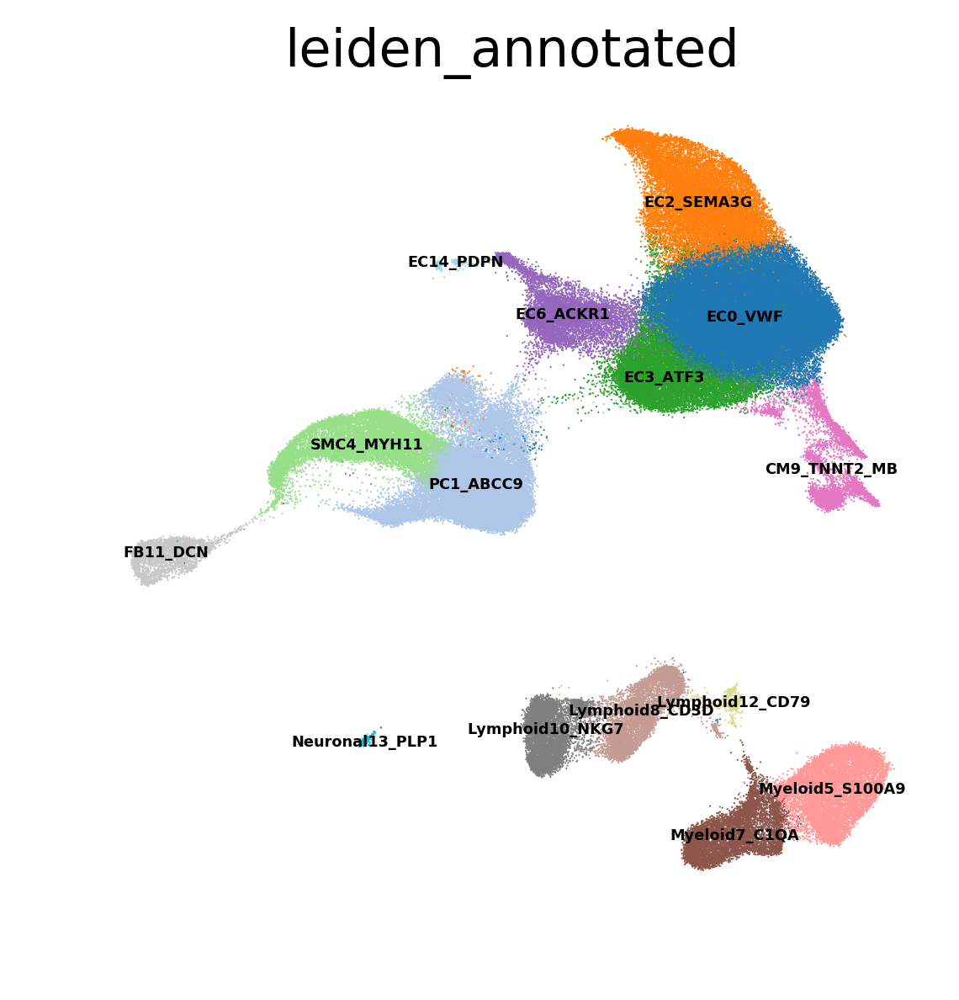

In [11]:
cells_export.obs['leiden_annotated'].cat.categories = ['EC0_VWF', 'PC1_ABCC9', 'EC2_SEMA3G', 'EC3_ATF3',  'SMC4_MYH11', 'Myeloid5_S100A9', 'EC6_ACKR1', 'Myeloid7_C1QA', 
                                                      'Lymphoid8_CD3D', 'CM9_TNNT2_MB', 'Lymphoid10_NKG7', 'FB11_DCN', 'Lymphoid12_CD79',  'Neuronal13_PLP1', 'EC14_PDPN']
sc.pl.umap(cells_export, color = ['leiden_annotated'], size = 1, legend_fontsize = 4, legend_loc = 'on data', palette = 'tab20', frameon = False)

In [12]:
cells_export.write('/home/jovyan/data/Dec/0-global/Velocity/hca_heart_CellsCD45_Velo_annotated_ml200109.h5ad')